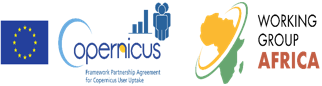



# **Day 1: EO data handling using Earth Engine and Colab Python**

Carlos Gonzales-Inca
University of Turku, Finland
email: cagoin@utu.fi

# Introduction

**Introduction**

Satellite imagery from several Earth Observation systems is multidimensional raster layers. For example, multispectral images contain several bands and in some cases metadata layers. Python provides a complete ecosystem of methods and tools for EO data analytics including libraries for Artificial and Machine Learning. Basic EO data handling and access libraries are for example GDAL, RasterIO, Xarray, RioArray, EE, GeeMap, LeafMap, pySTAC, others. Additionally, several free access cloud computing platforms such as Google Earth Engine, Microsoft Planetary Computer, Open Data Cube, and Copernicus Data Space Ecosystem. Most of these platforms already store data from different EO systems such as NASA’s satellites, the Copernicus programme, JAXA, and others.

In this exercise, you will familiarize yourself with some of these libraries and platforms for EO data processing by applying Machine Learning Methods using Python programming language.

L**earning objectives**

•	Copernicus data handling and cloud free mosaicking
•	Use GEE in Colab-Python platform

**Registration for Google Earth Engine**

Before Practical 3, please register for Google Earth Engine (GEE) using your gmail account

1) Go to https://earthengine.google.com/noncommercial/

2) Earth Engine will now request access to your Google account. Click ‘allow’.

3) Click the link to the registration page, fill out the application, and submit it.

4) After you receive the ‘Welcome to Google Earth Engine!’ email (within ~24 hr), you will be able to log in using your Google account on code.earthengine.google.com.

# Start Earth Engine in Colab-Python

In [ ]:
# Step 1: Start Google Earth Engine
# Register to https://earthengine.google.com/
import ee

In [ ]:
# Trigger the authentication flow.
ee.Authenticate()

To authorize access needed by Earth Engine, open the following URL in a web browser and follow the instructions. If the web browser does not start automatically, please manually browse the URL below.

    https://code.earthengine.google.com/client-auth?scopes=https%3A//www.googleapis.com/auth/earthengine%20https%3A//www.googleapis.com/auth/devstorage.full_control&request_id=4vaRFsEI8vTQInk1UQdG0Kaj5ac_kW6fj1zXTICQx1Q&tc=11izHCV9BDsFxN69zZxZKf9lFTKiQG7lFCprx6YwMME&cc=8q03_ZOCj0_Sa4dD9sNXGc-PNNm2IBSJAoJ2gCpkZA0

The authorization workflow will generate a code, which you should paste in the box below.
Enter verification code: 4/1AfJohXm1qBlCqBYFDyie1OccBT4knzo88by3ovKtp05AT_spB-dYLOh3It8

Successfully saved authorization token.


In [ ]:
# Start ee system.
ee.Initialize()

# Access to Earth Observation (EO) Data (Copernicus EO data)

In [ ]:
# Step 2: Define a study area polygon,
# e.g., get coordinates from https://geojson.io
AOI = ee.Geometry.Polygon([
          [
            [
              39.12458705126903,
              -5.715564275365551
            ],
            [
              39.12458705126903,
              -6.494802946383345
            ],
            [
              39.61284944895485,
              -6.494802946383345
            ],
            [
              39.61284944895485,
              -5.715564275365551
            ],
            [
              39.12458705126903,
              -5.715564275365551
            ]
          ]
        ])

In [ ]:
# Read your AOI bounds
AOI.getInfo()

{'type': 'Polygon',
 'coordinates': [[[39.12458705126903, -6.494802946383345],
   [39.61284944895485, -6.494802946383345],
   [39.61284944895485, -5.715564275365551],
   [39.12458705126903, -5.715564275365551],
   [39.12458705126903, -6.494802946383345]]]}

In [ ]:
# Step 3 : Get images of Sentinel 2 harmonized collection of Google Earth Engine for the study area
s2 = ee.ImageCollection("COPERNICUS/S2_SR_HARMONIZED")\
       .filterDate('2022-01-01','2023-07-31')\
       .filterBounds(AOI)\
       .filter(ee.Filter.lte('CLOUDY_PIXEL_PERCENTAGE', 30))

In [ ]:
# Check the image list
s2

Name,Description
B1,Aerosols
B2,Blue
B3,Green
B4,Red
B5,Red Edge 1
B6,Red Edge 2
B7,Red Edge 3
B8,NIR
B8A,Red Edge 4
B9,Water vapor


# Create a cloud-free image mosaic for your study area

In [ ]:
# Step 4 : Create a cloud free masaic images

# 4.1. Method A : Cloud masking using the QA60 bands
# Define cloud masking function m1
def cloud_mask_QA60(my_img):
    quality_band = my_img.select('QA60')
    cloud_Bit = 1 << 10 # 10^10 in base 2
    cirrus_Bit = 1 << 11 #  10^11 in base 2
    mask = quality_band.bitwiseAnd(cloud_Bit).eq(0) and (quality_band.bitwiseAnd(cirrus_Bit).eq(0))
    return my_img.updateMask(mask)

In [ ]:
# Iterate the masking function A over the image list using the ee "map" function
s2_mask1 = s2.map(cloud_mask_QA60)

In [ ]:
# Using the masked images, create a cloud free image by estimating the image band median
# In ee, the image has been scaled by 10000, so return to the original values, 0 – 1 of reflectance value

s2_mask1_mo = s2_mask1.median().divide(10000)

In [ ]:
# Import « geemap » library for interactive image visualization
#!pip install geemap

import geemap

In [ ]:
poi = AOI.centroid() # get the centroid coordinate of the study area
poi

ee.Geometry({
  "functionInvocationValue": {
    "functionName": "Geometry.centroid",
    "arguments": {
      "geometry": {
        "functionInvocationValue": {
          "functionName": "GeometryConstructors.Polygon",
          "arguments": {
            "coordinates": {
              "constantValue": [
                [
                  [
                    39.12458705126903,
                    -5.715564275365551
                  ],
                  [
                    39.12458705126903,
                    -6.494802946383345
                  ],
                  [
                    39.61284944895485,
                    -6.494802946383345
                  ],
                  [
                    39.61284944895485,
                    -5.715564275365551
                  ],
                  [
                    39.12458705126903,
                    -5.715564275365551
                  ]
                ]
              ]
            },
            "evenOdd": {
              "constantValue": true
            }
          }
        }
      }
    }
  }
})

In [ ]:
# Visualize the map
Map = geemap.Map(center= [-6.11,39.37], zoom= 8);
url = 'https://mt1.google.com/vt/lyrs=y&x={x}&y={y}&z={z}' # Add google satellite image
Map.add_tile_layer(url, name='Google Satellite', attribution='Google')

Map.addLayer(s2_mask1_mo, {'bands': ['B11', 'B8', 'B2'], 'min': 0, 'max': 0.5}, "S2_mask1_mo"); #??
Map.addLayerControl();
Map

Map(center=[-6.11, 39.37], controls=(WidgetControl(options=['position', 'transparent_bg'], widget=HBox(childre…

In [ ]:
# 4.2. Method B: Cloud masking using Scene Classification Layer (SCL)
def cloud_mask_scl_fun (image):
  scl = image.select('SCL')
  saturated = scl.eq(1)
  cloud_shadow = scl.eq(3)
  cloud_low_prob = scl.eq(7)
  cloud_med_prob = scl.eq(8)
  cloud_high_prob = scl.eq(9)
  cirrus = scl.eq(10) # 10 = cirrus
  mask = saturated.neq(1)\
               and(cloud_shadow.neq(1))\
               and(cloud_low_prob.neq(1))\
               and(cloud_med_prob.neq(1))\
               and(cloud_high_prob.neq(1))\
               and(cirrus.neq(1))
  return image.updateMask(mask)

In [ ]:
# Iterate the « masking function B » over the image list using the ee "map" function

s2_mask2 = s2.map(cloud_mask_scl_fun)

In [ ]:
# Create the IMAGE MOSAIC by estimating the “meadian”.
# Returnthe scale value to 0 to 1 range of reflectance value
s2_mosk2_mo = s2_mask2.median().divide(10000)

In [ ]:
# Display the masked mosaic
Map.addLayer(s2_mosk2_mo, {'bands': ['B11', 'B8', 'B2'], 'min': 0, 'max': 0.5}, "S2_mosk2_mo")
Map

In [ ]:
# 4.3. Method C: Using Cloud probabilty data generated with Light Gradient Boosting Machine (LightGBM)
# https://developers.google.com/earth-engine/datasets/catalog/COPERNICUS_S2_CLOUD_PROBABILITY#description

In [ ]:
# get the Cloud probability dataset
s2_cloud_prob_col = (ee.ImageCollection('COPERNICUS/S2_CLOUD_PROBABILITY')
        .filterBounds(AOI)
        .filterDate('2020-01-01', '2023-07-31'))

# see the image list
s2_cloud_prob_col

Name,Description
probability,Probability that the pixel is cloudy.


In [ ]:
# Filter s2 dataset to match cloud probability dataset

s2_cloud_prob_filtered = ee.ImageCollection(ee.Join.saveFirst('s2cloudless').apply(**{
        'primary': s2,
        'secondary': s2_cloud_prob_col,
        'condition': ee.Filter.equals(**{
            'leftField': 'system:index',
            'rightField': 'system:index'
        })
    }))


In [ ]:
# Read the images list
s2_cloud_prob_filtered


Name,Description
B1,Aerosols
B2,Blue
B3,Green
B4,Red
B5,Red Edge 1
B6,Red Edge 2
B7,Red Edge 3
B8,NIR
B8A,Red Edge 4
B9,Water vapor


In [ ]:
# Define some parameters

CLOUD_FILTER = 60 # Maximum image cloud cover percent allowed in image collection
CLD_PRB_THRESH = 50 # Cloud probability (%); values greater than are considered cloud
NIR_DRK_THRESH = 0.15 # Near-infrared reflectance; values less than are considered potential cloud shadow
CLD_PRJ_DIST = 1 # Maximum distance (km) to search for cloud shadows from cloud edges
BUFFER = 50 # Distance (m) to dilate the edge of cloud-identified objects


In [ ]:
# Define cloud mask component functions C
def add_cloud_bands(img):
    # Get s2cloudless image, subset the probability band.
    cld_prb = ee.Image(img.get('s2cloudless')).select('probability')

    # Condition s2cloudless by the probability threshold value.
    is_cloud = cld_prb.gt(CLD_PRB_THRESH).rename('clouds')

    # Add the cloud probability layer and cloud mask as image bands.
    return img.addBands(ee.Image([cld_prb, is_cloud]))


In [ ]:
# Define a function to add dark pixels, cloud projection, and shadows

def add_shadow_bands(img):
    # Identify water pixels from the SCL band.
    not_water = img.select('SCL').neq(6)

    # Identify dark NIR pixels that are not water (potential cloud shadow pixels).
    SR_BAND_SCALE = 1e4
    dark_pixels = img.select('B8').lt(NIR_DRK_THRESH*SR_BAND_SCALE).multiply(not_water).rename('dark_pixels')

    # Determine the direction to project cloud shadow from clouds (assumes UTM projection).
    shadow_azimuth = ee.Number(90).subtract(ee.Number(img.get('MEAN_SOLAR_AZIMUTH_ANGLE')));

    # Project shadows from clouds for the distance specified by the CLD_PRJ_DIST input.
    cld_proj = (img.select('clouds').directionalDistanceTransform(shadow_azimuth, CLD_PRJ_DIST*10)
        .reproject(**{'crs': img.select(0).projection(), 'scale': 100})
        .select('distance')
        .mask()
        .rename('cloud_transform'))

    # Identify the intersection of dark pixels with cloud shadow projection.
    shadows = cld_proj.multiply(dark_pixels).rename('shadows')

    # Add dark pixels, cloud projection, and identified shadows as image bands.
    return img.addBands(ee.Image([dark_pixels, cld_proj, shadows]))



In [ ]:
# Final cloud-shadow mask
def add_cld_shdw_mask(img):
    # Add cloud component bands.
    img_cloud = add_cloud_bands(img)

    # Add cloud shadow component bands.
    img_cloud_shadow = add_shadow_bands(img_cloud)

    # Combine cloud and shadow mask, set cloud and shadow as value 1, else 0.
    is_cld_shdw = img_cloud_shadow.select('clouds').add(img_cloud_shadow.select('shadows')).gt(0)

    # Remove small cloud-shadow patches and dilate remaining pixels by BUFFER input.
    # 20 m scale is for speed, and assumes clouds don't require 10 m precision.
    is_cld_shdw = (is_cld_shdw.focalMin(2).focalMax(BUFFER*2/20)
        .reproject(**{'crs': img.select([0]).projection(), 'scale': 20})
        .rename('cloudmask'))

    # Add the final cloud-shadow mask to the image.
    return img_cloud_shadow.addBands(is_cld_shdw)

In [ ]:
# create a mask layer for each images
s2_cloud_prob_mask = s2_cloud_prob_filtered.map(add_cld_shdw_mask)

s2_cloud_prob_mask

Name,Description
B1,Aerosols
B2,Blue
B3,Green
B4,Red
B5,Red Edge 1
B6,Red Edge 2
B7,Red Edge 3
B8,NIR
B8A,Red Edge 4
B9,Water vapor


In [ ]:
# Define a function for cloud masking C each images
def apply_cld_shdw_mask(img):
    # Subset the cloudmask band and invert it so clouds/shadow are 0, else 1.
    not_cld_shdw = img.select('cloudmask').Not()

    # Subset reflectance bands and update their masks, return the result.
    return img.select('B.*').updateMask(not_cld_shdw)

In [ ]:
# Create a  Cloud masked image mosaic using the method C.
# Return the value to 0 to 1
s2_mask3_mo = (s2_cloud_prob_mask.map(apply_cld_shdw_mask)
                             .median().divide(10000))

In [ ]:
# Make a visualization of the created image mosaic
Map.addLayer(s2_mask3_mo, {'bands': ['B11', 'B8', 'B2'], 'min': 0, 'max': 0.5}, "S2_mask3_mo")
Map

# Export you Cloud-free image mosaic to Google drive and GEE assesst

In [ ]:
# Step 5: Export the image to your Google Drive and Google Earth Engine Assesst
# Connect to your Google Drive
from google.colab import drive
drive.mount('/content/drive')

In [ ]:
# Export your best cloud free mosaic image to your google drive, specifying scale and region.
task = ee.batch.Export.image.toDrive(**{
    'image': s2_mask3_mo,
    'description': 's2_mask3_mo2',
    'folder':'Colab_My_Output',
    'scale': 20,
    'region': AOI.getInfo()['coordinates']
})
task.start()

In [ ]:
# Export the image to an Earth Engine asset.
task2 = ee.batch.Export.image.toAsset(**{
  'image': s2_mask3_mo,
  'description': 's2_mask3_mo',
  'assetId': 'projects/YOUR_USER/assets/FILE_NAME',
  'scale': 20,
  'region': AOI.getInfo()['coordinates']
})
task2.start()

In [ ]:
import time

In [ ]:
while task2.active():
  print('Polling for task (id: {}).'.format(task2.id))
  time.sleep(5)

Polling for task (id: C7GQEZL4XN3ADIDZFSSEIBG3).
Polling for task (id: C7GQEZL4XN3ADIDZFSSEIBG3).
Polling for task (id: C7GQEZL4XN3ADIDZFSSEIBG3).
Polling for task (id: C7GQEZL4XN3ADIDZFSSEIBG3).
Polling for task (id: C7GQEZL4XN3ADIDZFSSEIBG3).
Polling for task (id: C7GQEZL4XN3ADIDZFSSEIBG3).
Polling for task (id: C7GQEZL4XN3ADIDZFSSEIBG3).
Polling for task (id: C7GQEZL4XN3ADIDZFSSEIBG3).
Polling for task (id: C7GQEZL4XN3ADIDZFSSEIBG3).
Polling for task (id: C7GQEZL4XN3ADIDZFSSEIBG3).
Polling for task (id: C7GQEZL4XN3ADIDZFSSEIBG3).
Polling for task (id: C7GQEZL4XN3ADIDZFSSEIBG3).
Polling for task (id: C7GQEZL4XN3ADIDZFSSEIBG3).
Polling for task (id: C7GQEZL4XN3ADIDZFSSEIBG3).
Polling for task (id: C7GQEZL4XN3ADIDZFSSEIBG3).
Polling for task (id: C7GQEZL4XN3ADIDZFSSEIBG3).
Polling for task (id: C7GQEZL4XN3ADIDZFSSEIBG3).
Polling for task (id: C7GQEZL4XN3ADIDZFSSEIBG3).
Polling for task (id: C7GQEZL4XN3ADIDZFSSEIBG3).
Polling for task (id: C7GQEZL4XN3ADIDZFSSEIBG3).
Polling for task (id